Задание:

1. Реализовать детектор лиц на основе метода Template Matching.
2. Рассмотреть варианты детектора с различными шаблонами (целое лицо или его
фрагменты).
3. Исследовать качество детектирования лиц в различных условиях (освещение, его
неравномерность, повороты/наклон лица, сокрытие различных частей лица
(**использование маски и деиндентификация**), расстояние от камеры и т.д.).
4. Сделать заключение и оценить работу собственного детектора.

In [1]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
import os
import time
from tqdm.notebook import trange

Перебор всевозможных размеров шаблона; размер лица на входном изображении может быть любым.\
В качестве шаблона используется ТОЛЬКО целое лицо!

In [2]:
def face_recogn1(img, templates, method):
    scale_step = 0.1
    scale = 0.1
    max_width = img.shape[1]
    max_height = img.shape[0]
    found = None
    while True:
        width = int(templates[0].shape[1] * scale)
        height = int(templates[0].shape[0] * scale)
        if width > max_width or height > max_height:
            break
        dim = (width, height)
        for i in range(len(templates)):
            template2 = cv.resize(templates[i], dim, interpolation = cv.INTER_AREA)
            res = cv.matchTemplate(img,template2,eval(method))
            min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
            if method in ['cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']:
                #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
                if found is None or min_val / width / height < found[0]: #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
                    found = (min_val / width / height, min_loc, width, height) #!!!!!!!!!!!!!!!!!!!!!!!!!!
                #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
            else:
                if found is None or max_val > found[0]:
                    found = (max_val, max_loc, width, height)
        
        scale += scale_step
    return (found[1], (found[1][0] + found[2], found[1][1] + found[3])) if not found is None else None

In [3]:
def display_line1(img, image_name, methods, templates, template_name, face_recogn, idx):
    plt.rcParams["figure.figsize"] = (20,4)
    plt.subplot(1, len(methods) + 2, 1), plt.imshow(img,cmap = 'gray')
    plt.title('Input Image'), plt.axis("off")
    if not idx is None:
        plt.subplot(1, len(methods) + 2, 2), plt.imshow(templates[idx],cmap = 'gray')
        plt.title('Template'), plt.axis("off")
    for j in range(len(methods)):
        top_left, bottom_right = face_recogn(img, templates if idx is None else [templates[idx]], methods[j])
        cropped_img = img[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
        plt.subplot(1, len(methods) + 2, j + 3),plt.imshow(cropped_img,cmap = 'gray')
        plt.title(methods[j]), plt.axis("off")
    plt.suptitle(f"Image: {image_name}, Template: {template_name}")
    plt.show()

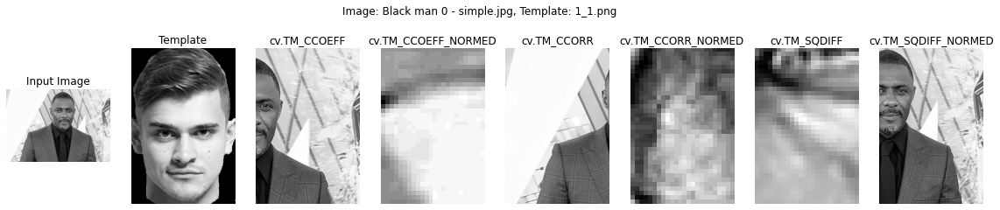

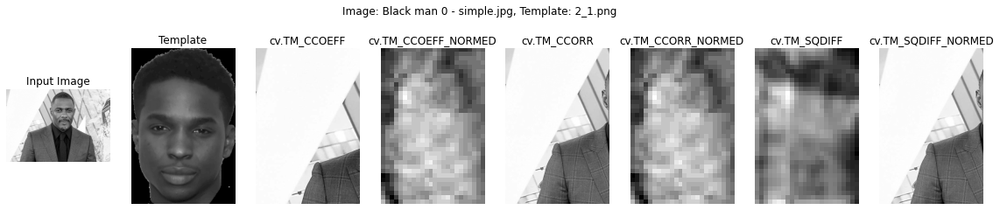

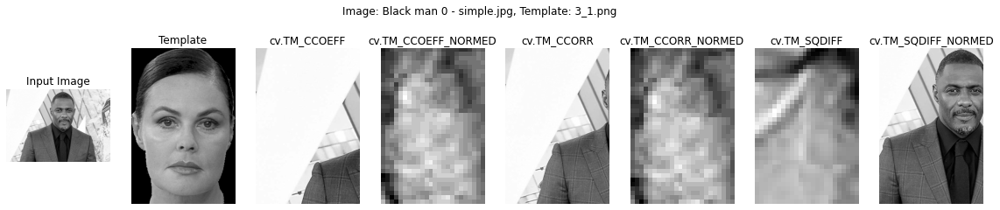

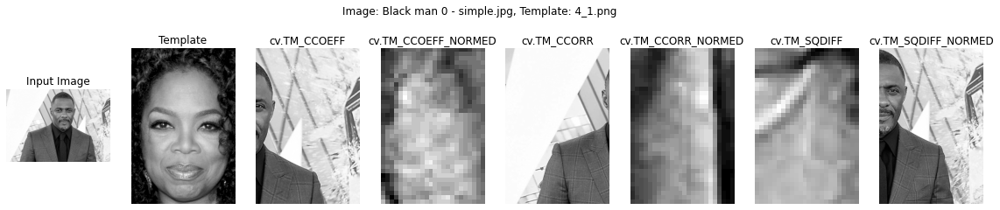

KeyboardInterrupt: 

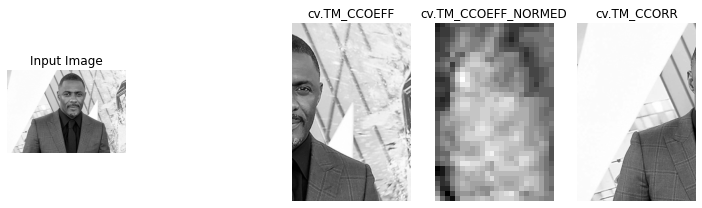

In [5]:
templates_folder_name = 'templates'
images_folder_name = 'images'
methods = ['cv.TM_CCOEFF', 'cv.TM_CCOEFF_NORMED', 'cv.TM_CCORR',
            'cv.TM_CCORR_NORMED', 'cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']
template_names = ['1_1.png', '2_1.png', '3_1.png', '4_1.png']

templates = []
for template_name in template_names:
    templates.append(cv.imread(f'{templates_folder_name}/{template_name}',0))

max_available_width = 1024

for image_name in os.listdir(images_folder_name):
    img = cv.imread(f'{images_folder_name}/{image_name}',0)
    if img.shape[1] > max_available_width:
        new_width = max_available_width
        new_height = int(img.shape[0] * max_available_width / img.shape[1])
        img = cv.resize(img, (new_width, new_height), interpolation = cv.INTER_AREA)
    
    for i in range(len(templates)):
        display_line1(img, image_name, methods, templates, template_names[i], face_recogn1, i)
    display_line1(img, image_name, methods, templates, "the best", face_recogn1, None)

Фиксированный размер шаблона. Фотографии вручную предобработаны, чтобы размер шаблона *примерно* соответствовал размеру лица на фотографии.\
Шаблоны частей лица не используются.

In [6]:
def face_recogn2(img, templates, method):
    found = None
    for i in range(len(templates)):
        res = cv.matchTemplate(img,templates[i],eval(method))
        min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)
        if method in ['cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']:
            if found is None or min_val < found[0]:
                found = (min_val, min_loc)
        else:
            if found is None or max_val > found[0]:
                found = (max_val, max_loc)
    return (found[1], (found[1][0] + templates[0].shape[1], found[1][1] + templates[0].shape[0]))

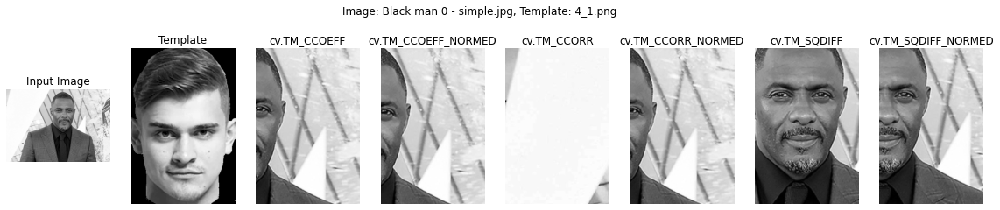

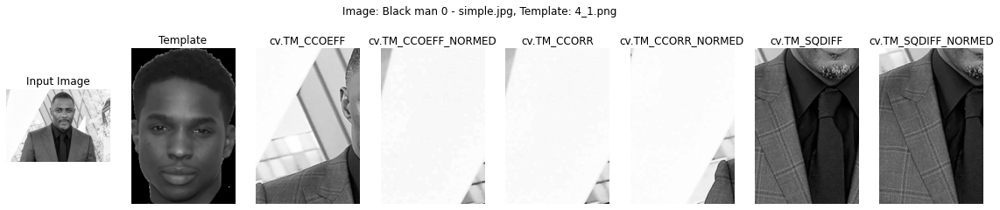

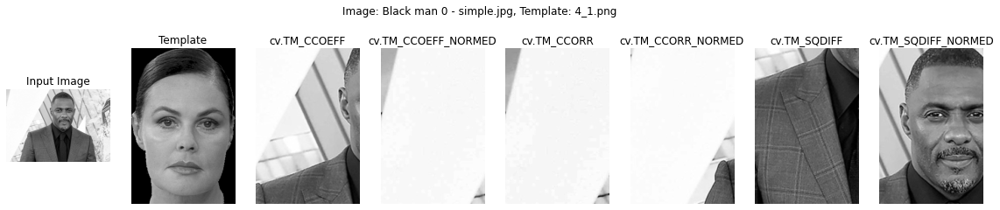

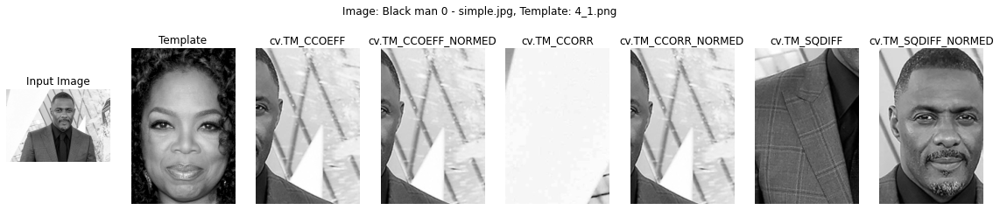

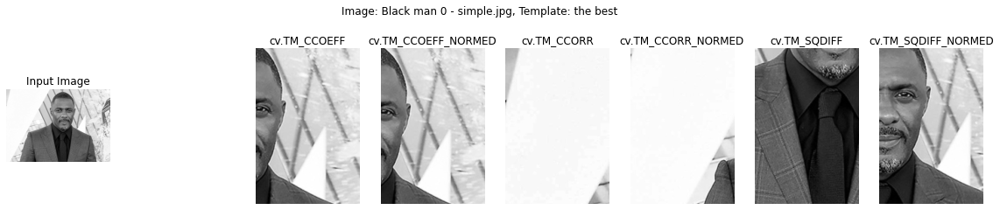

...

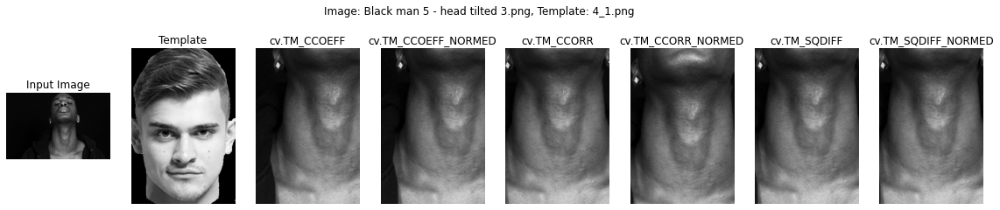

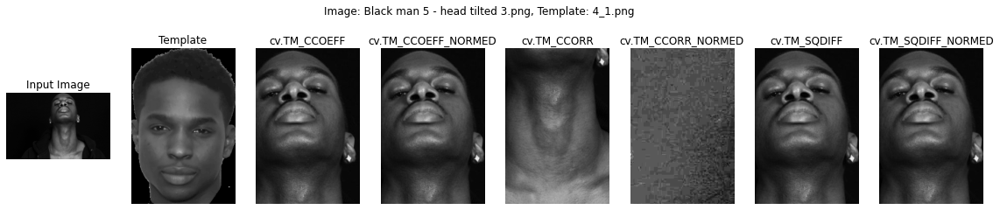

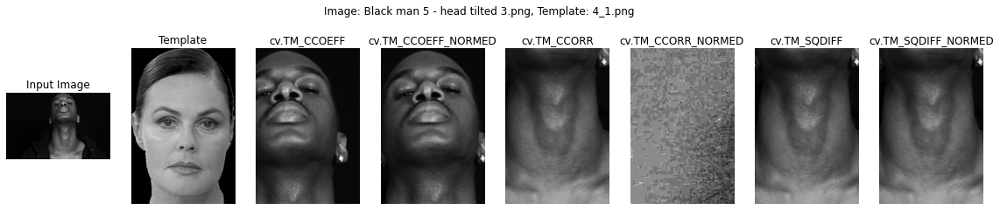

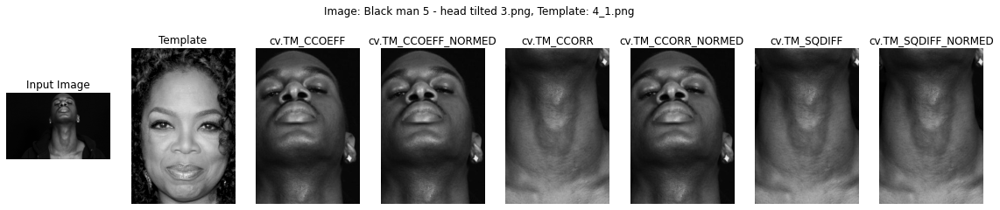

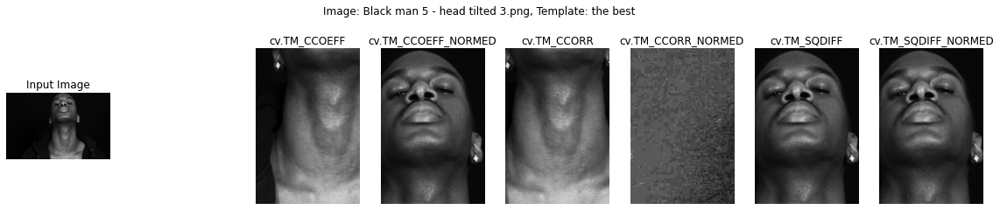

KeyboardInterrupt: 

In [7]:
templates_folder_name = 'templates'
images_folder_name = 'images'
methods = ['cv.TM_CCOEFF', 'cv.TM_CCOEFF_NORMED', 'cv.TM_CCORR',
            'cv.TM_CCORR_NORMED', 'cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']
template_names = ['1_1.png', '2_1.png', '3_1.png', '4_1.png']

templates = []
for template_name in template_names:
    templates.append(cv.imread(f'{templates_folder_name}/{template_name}',0))

for image_name in os.listdir(images_folder_name):
    img = cv.imread(f'{images_folder_name}/{image_name}',0)
    for i in range(len(templates)):
        display_line1(img, image_name, methods, templates, template_name, face_recogn2, i)
    display_line1(img, image_name, methods, templates, "the best", face_recogn2, None)

Фиксированный размер шаблона. Фотографии вручную предобработаны, чтобы размер шаблона примерно соответствовал размеру лица на фотографии.\
Для корректировки результата используются шаблоны частей лица.

In [8]:
def face_recogn3(img, templates):
    method = cv.TM_SQDIFF_NORMED
    found = None
    for i in range(len(templates)):
        face_template = templates[i][0]
        part_templates = templates[i][1]
        locations = templates[i][2]
        res = cv.matchTemplate(img, face_template, method)
        templates_res = []
        for template in part_templates:
            templates_res.append(cv.matchTemplate(img, template, method))
        suc = np.ones(res.shape)

        start_min_val, start_max_val, _, _ = cv.minMaxLoc(res)

        for counter in trange(max_count):
            min_val, max_val, min_loc, _ = cv.minMaxLoc(res)
            if (max_val - min_val < 1e-6 or
                (min_val - start_min_val) > treshold * (start_max_val - start_min_val)):
                break
            top_left = min_loc
            bottom_right = (top_left[0] + face_template.shape[1], top_left[1] + face_template.shape[0])
            cropped_img = img[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
            sum_dist = 0.0
            for i in range(len(part_templates)):
                min_val2, max_val2, _, _ = cv.minMaxLoc(templates_res[i])
                loc = tuple([sum(x) for x in zip(top_left[::-1],locations[i])])
                sum_dist += (templates_res[i][loc] - min_val2) / (max_val2 - min_val2)
            center = min_loc[::-1]
            suc[center] = sum_dist + counter * mult
            for i in range(center[0] - del_range, center[0] + del_range + 1):
                for j in range(center[1] - del_range, center[1] + del_range + 1):
                    if i >= 0 and i < res.shape[0] and j >= 0 and j < res.shape[1]:
                        res[(i,j)] = max_val
        
        min_val, _, min_loc, _ = cv.minMaxLoc(suc)
        return (min_loc, (min_loc[0] + face_template.shape[1], min_loc[1] + face_template.shape[0]), res, min_val)

  0%|          | 0/2000 [00:00<?, ?it/s]

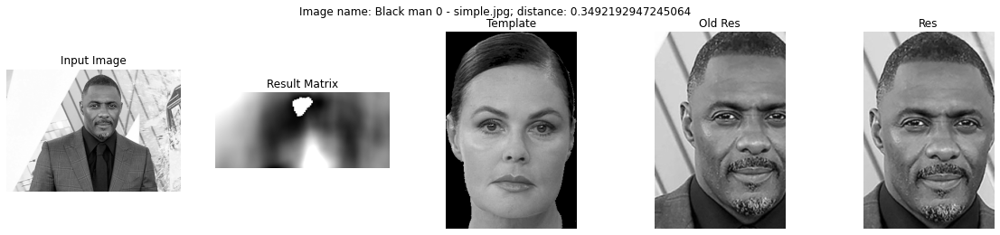

  0%|          | 0/2000 [00:00<?, ?it/s]

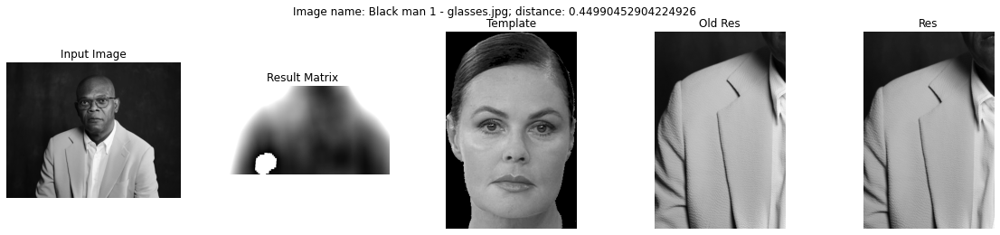

  0%|          | 0/2000 [00:00<?, ?it/s]

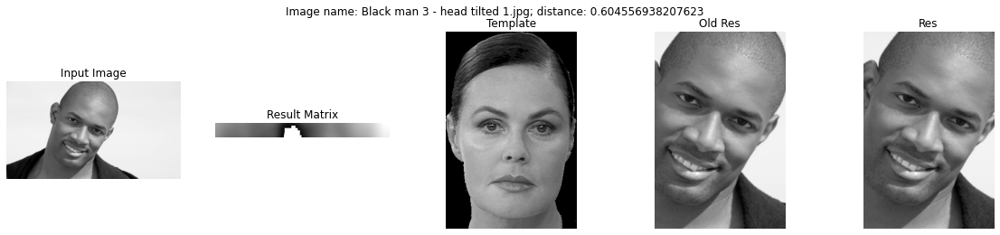

  0%|          | 0/2000 [00:00<?, ?it/s]

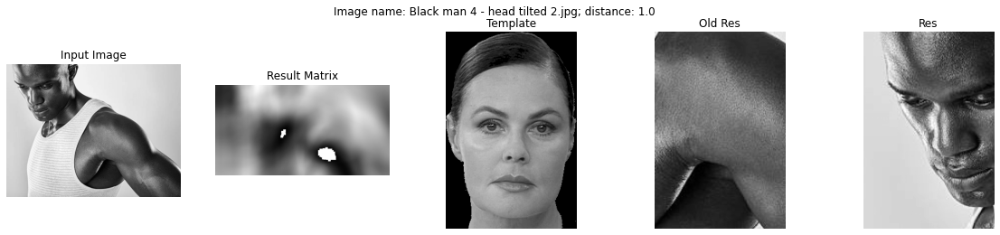

  0%|          | 0/2000 [00:00<?, ?it/s]

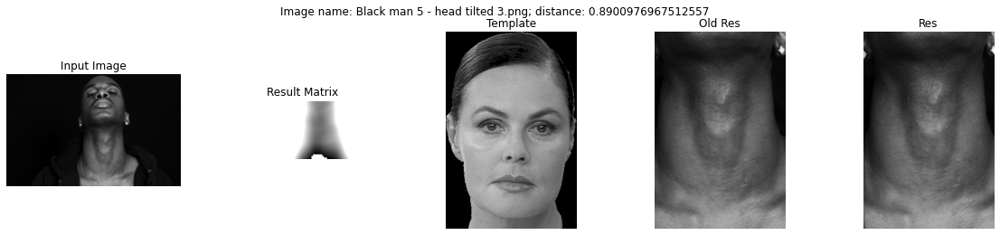

  0%|          | 0/2000 [00:00<?, ?it/s]

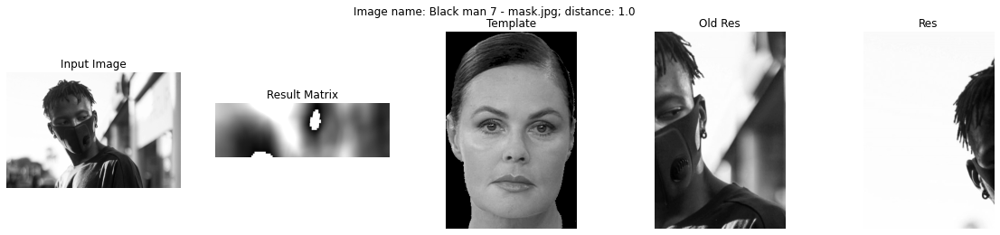

  0%|          | 0/2000 [00:00<?, ?it/s]

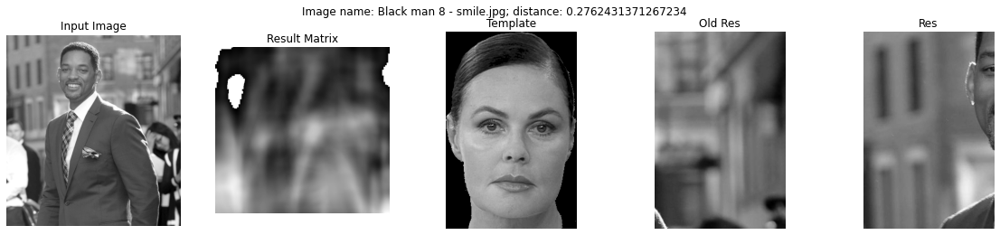

  0%|          | 0/2000 [00:00<?, ?it/s]

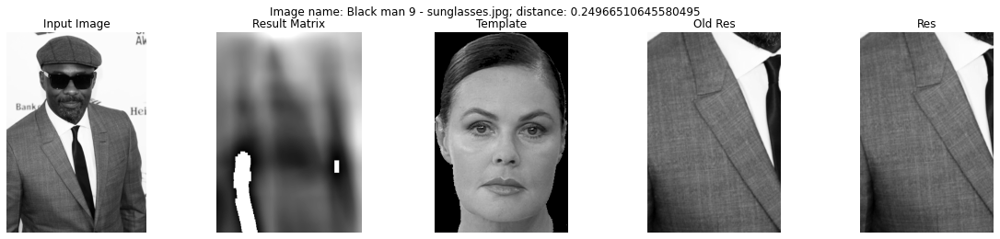

  0%|          | 0/2000 [00:00<?, ?it/s]

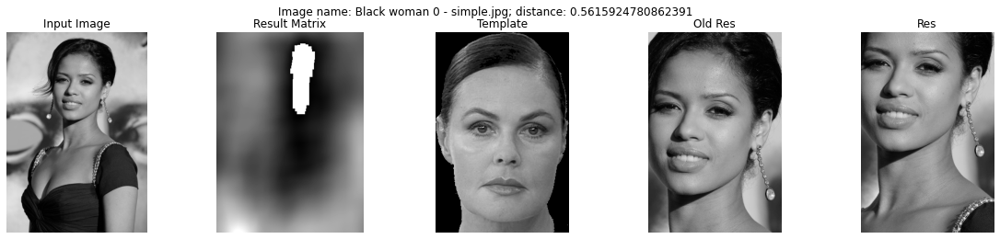

  0%|          | 0/2000 [00:00<?, ?it/s]

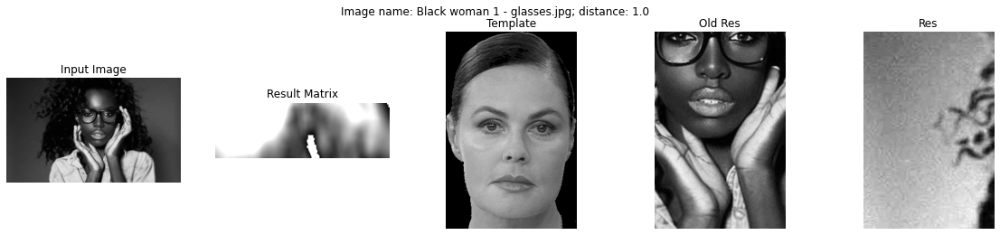

  0%|          | 0/2000 [00:00<?, ?it/s]

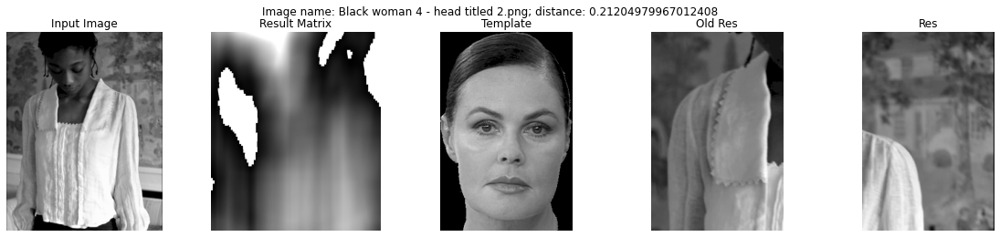

  0%|          | 0/2000 [00:00<?, ?it/s]

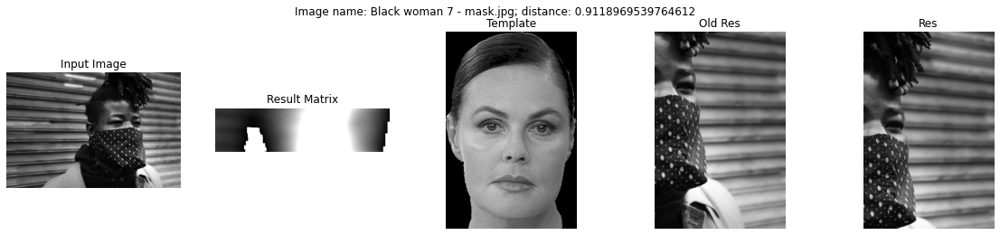

  0%|          | 0/2000 [00:00<?, ?it/s]

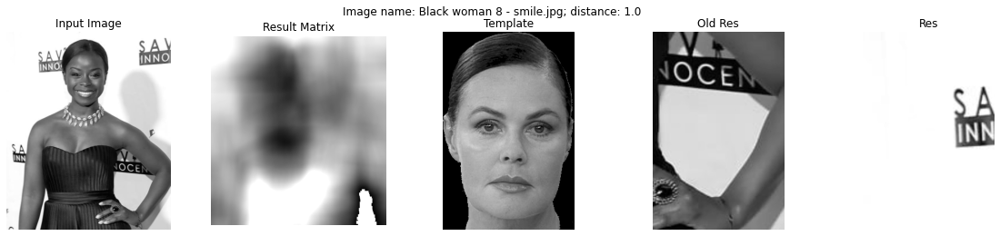

  0%|          | 0/2000 [00:00<?, ?it/s]

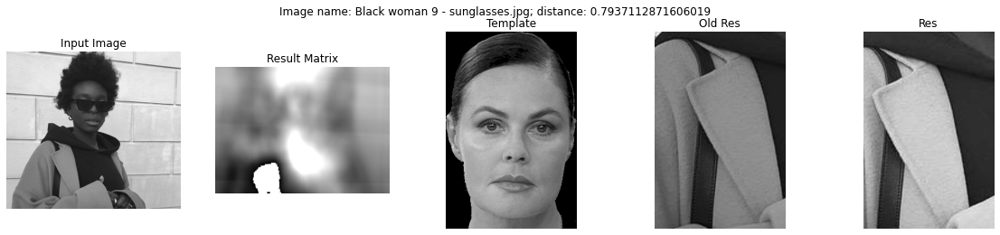

  0%|          | 0/2000 [00:00<?, ?it/s]

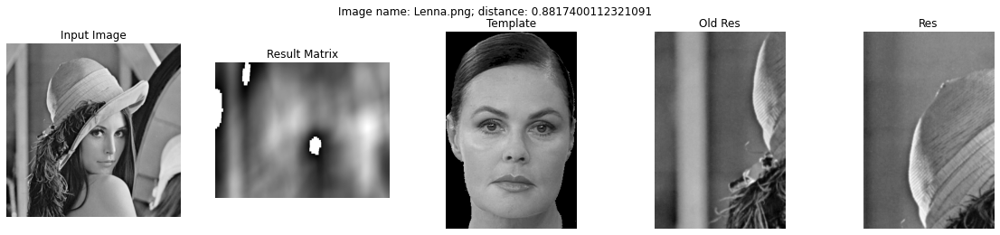

  0%|          | 0/2000 [00:00<?, ?it/s]

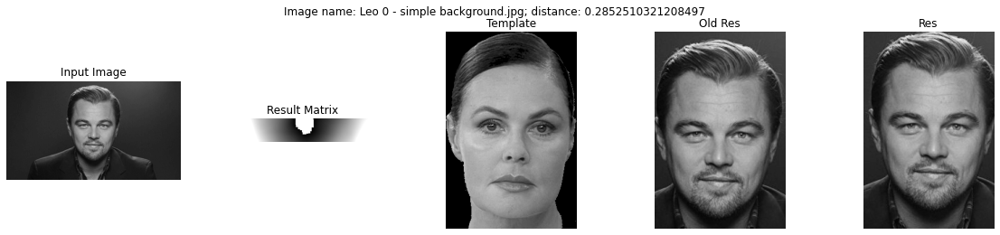

  0%|          | 0/2000 [00:00<?, ?it/s]

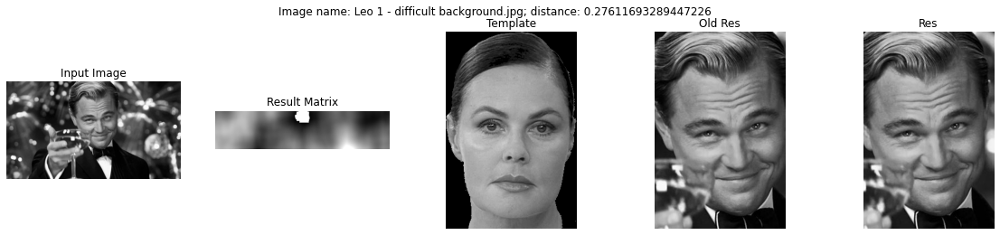

  0%|          | 0/2000 [00:00<?, ?it/s]

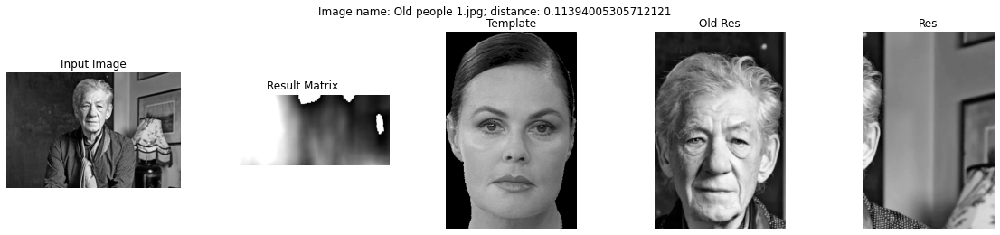

  0%|          | 0/2000 [00:00<?, ?it/s]

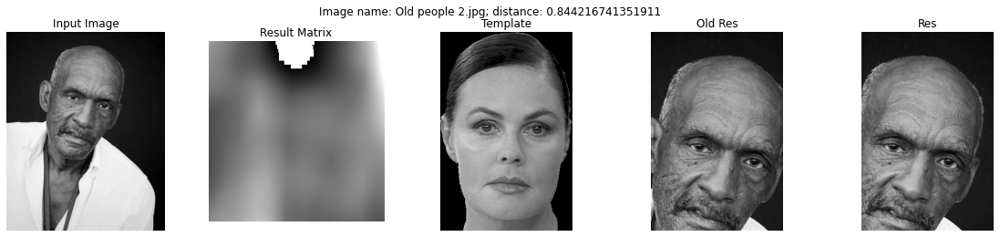

  0%|          | 0/2000 [00:00<?, ?it/s]

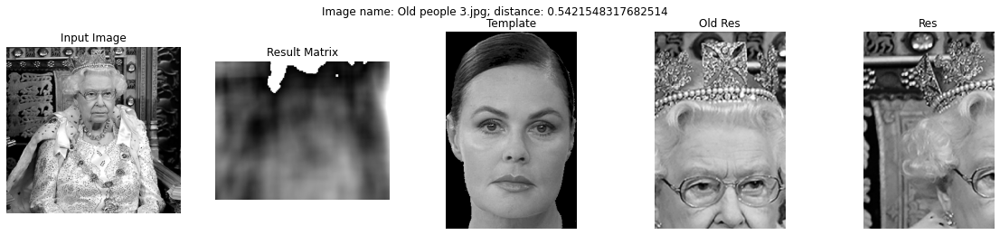

  0%|          | 0/2000 [00:00<?, ?it/s]

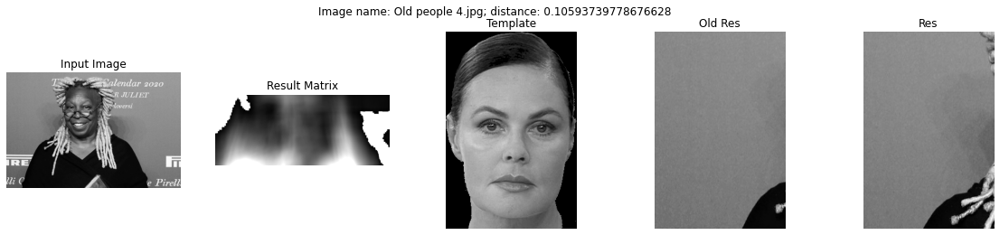

  0%|          | 0/2000 [00:00<?, ?it/s]

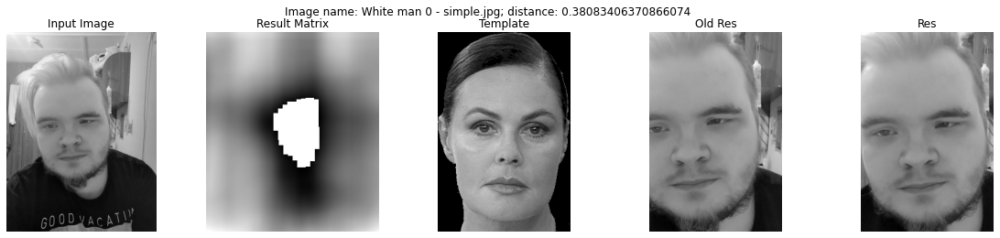

  0%|          | 0/2000 [00:00<?, ?it/s]

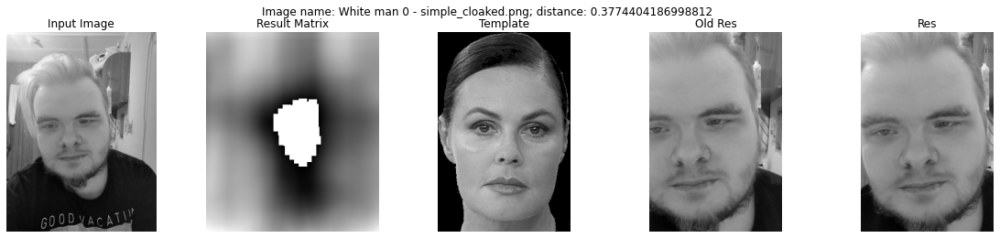

  0%|          | 0/2000 [00:00<?, ?it/s]

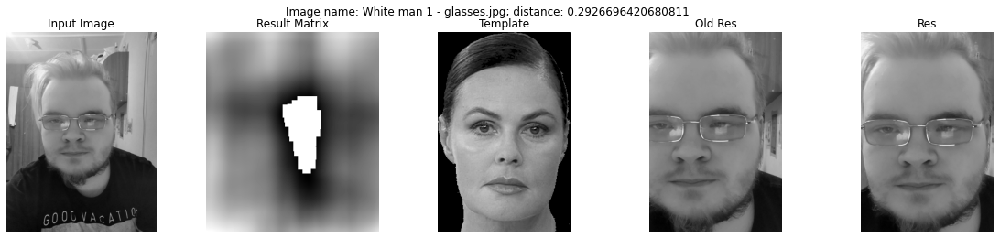

  0%|          | 0/2000 [00:00<?, ?it/s]

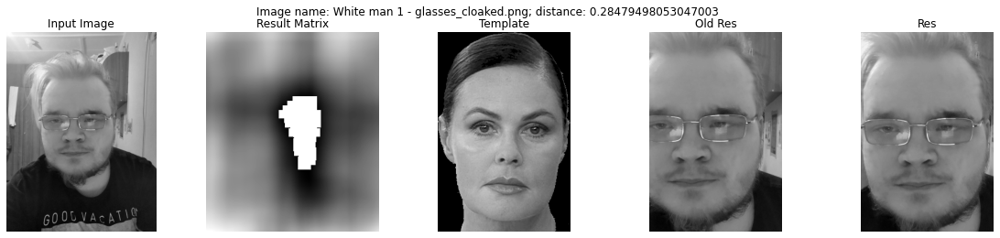

  0%|          | 0/2000 [00:00<?, ?it/s]

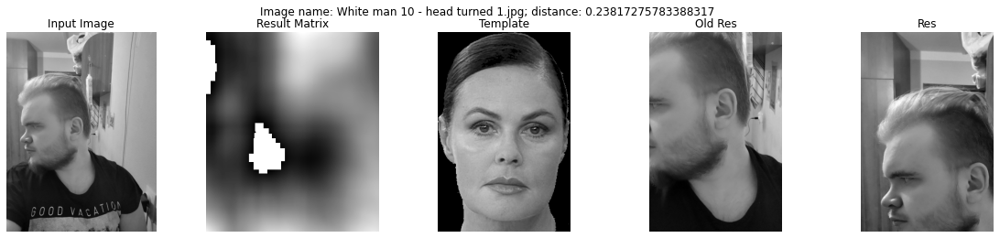

  0%|          | 0/2000 [00:00<?, ?it/s]

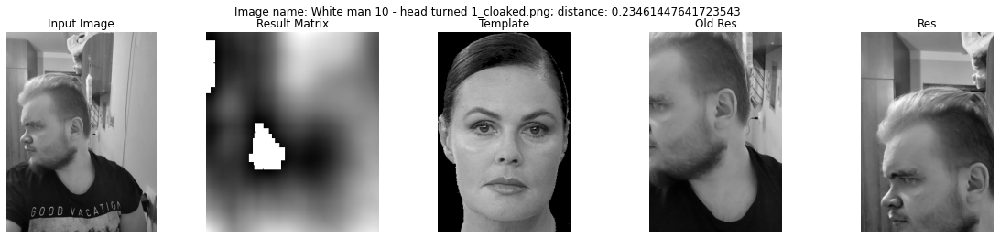

  0%|          | 0/2000 [00:00<?, ?it/s]

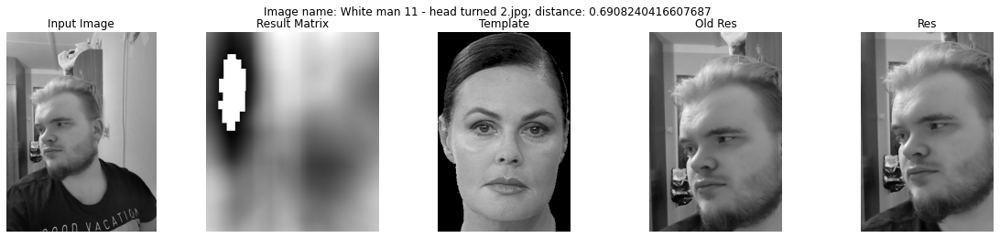

  0%|          | 0/2000 [00:00<?, ?it/s]

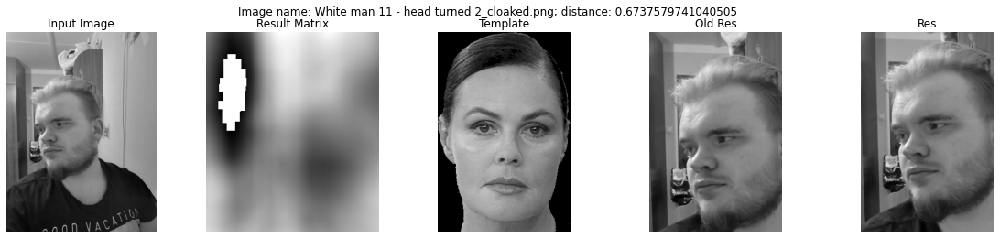

  0%|          | 0/2000 [00:00<?, ?it/s]

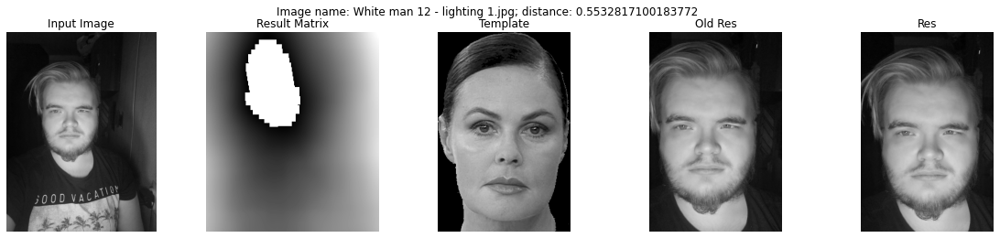

  0%|          | 0/2000 [00:00<?, ?it/s]

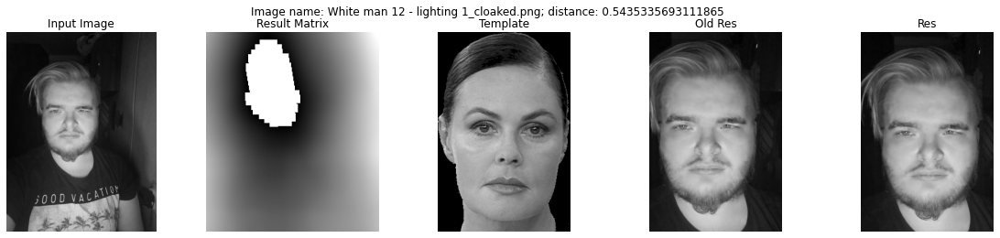

  0%|          | 0/2000 [00:00<?, ?it/s]

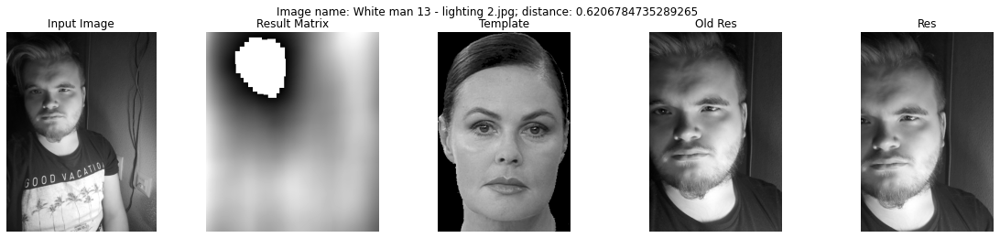

  0%|          | 0/2000 [00:00<?, ?it/s]

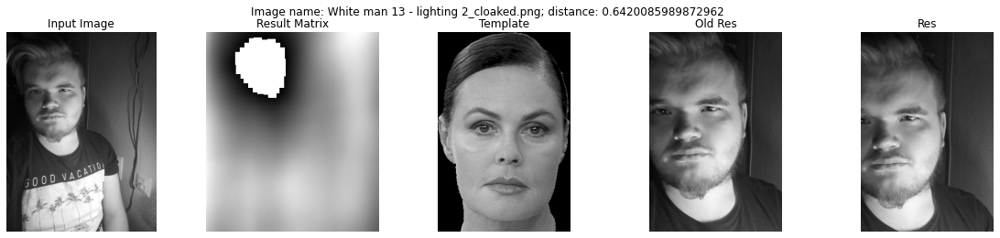

  0%|          | 0/2000 [00:00<?, ?it/s]

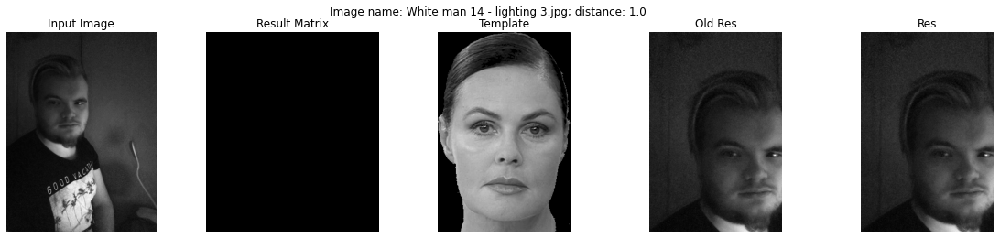

  0%|          | 0/2000 [00:00<?, ?it/s]

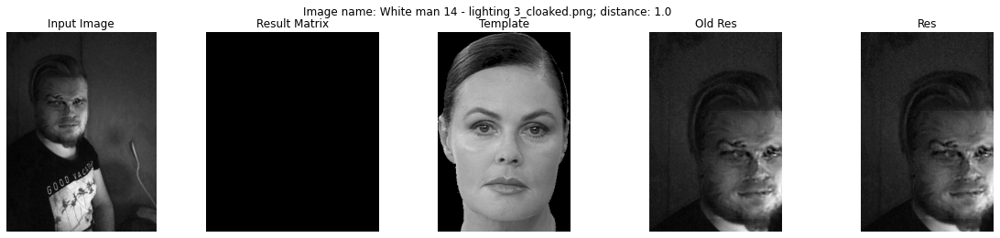

  0%|          | 0/2000 [00:00<?, ?it/s]

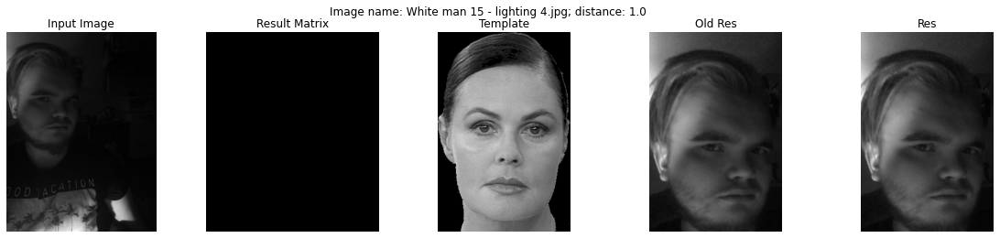

  0%|          | 0/2000 [00:00<?, ?it/s]

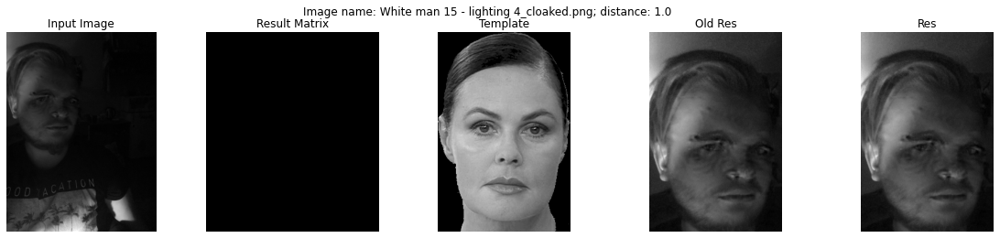

  0%|          | 0/2000 [00:00<?, ?it/s]

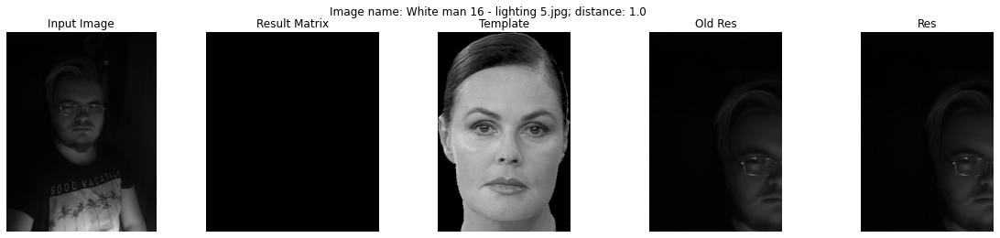

  0%|          | 0/2000 [00:00<?, ?it/s]

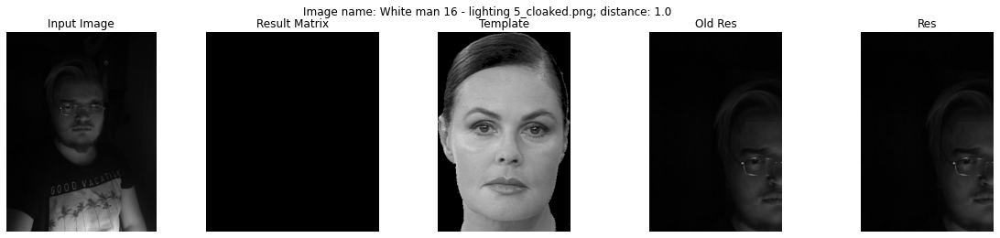

  0%|          | 0/2000 [00:00<?, ?it/s]

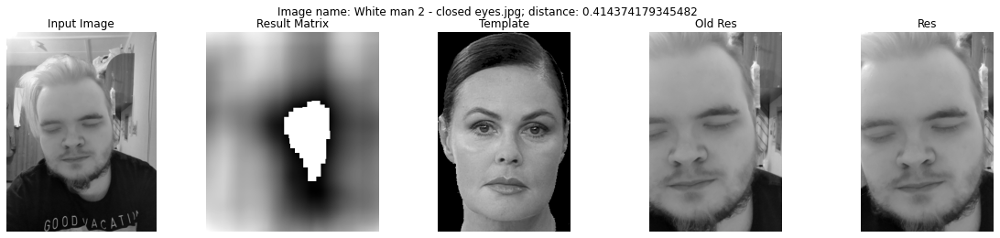

  0%|          | 0/2000 [00:00<?, ?it/s]

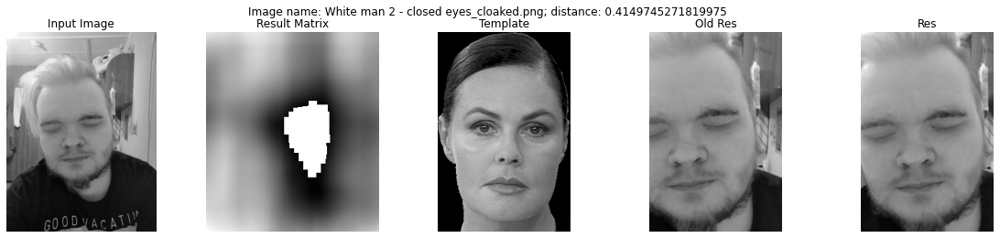

  0%|          | 0/2000 [00:00<?, ?it/s]

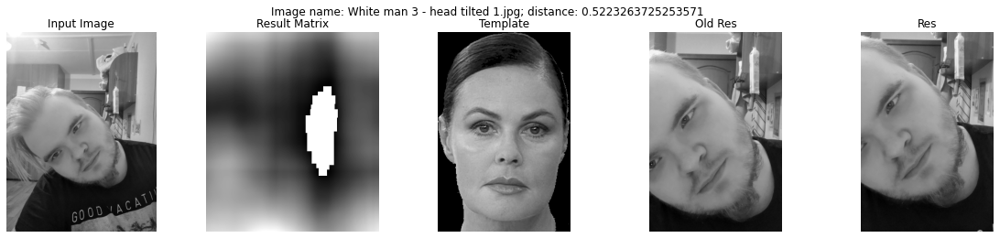

  0%|          | 0/2000 [00:00<?, ?it/s]

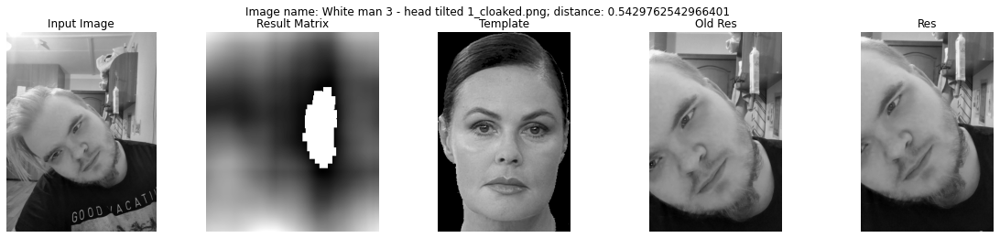

  0%|          | 0/2000 [00:00<?, ?it/s]

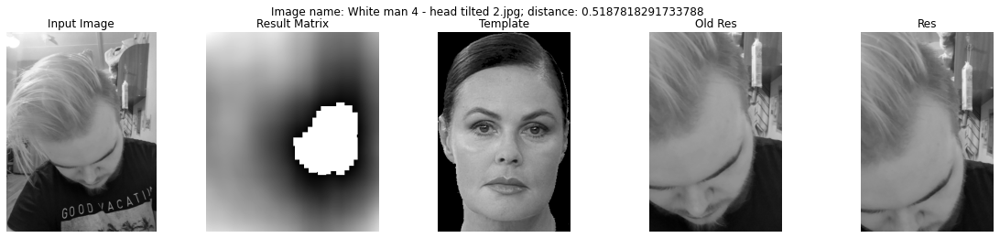

  0%|          | 0/2000 [00:00<?, ?it/s]

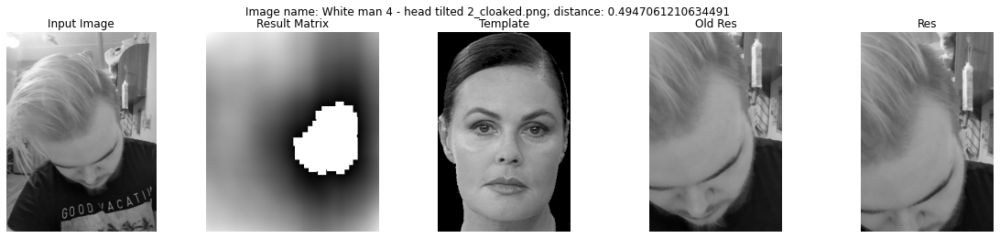

  0%|          | 0/2000 [00:00<?, ?it/s]

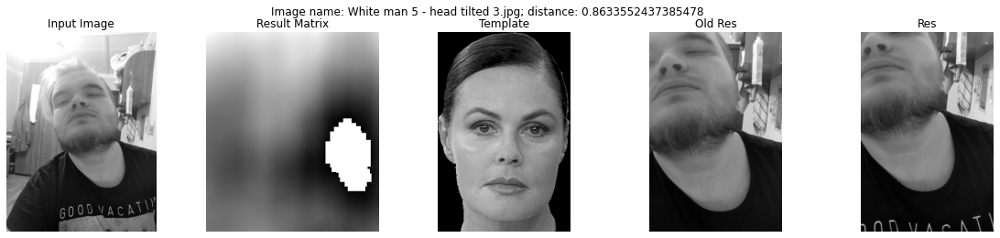

  0%|          | 0/2000 [00:00<?, ?it/s]

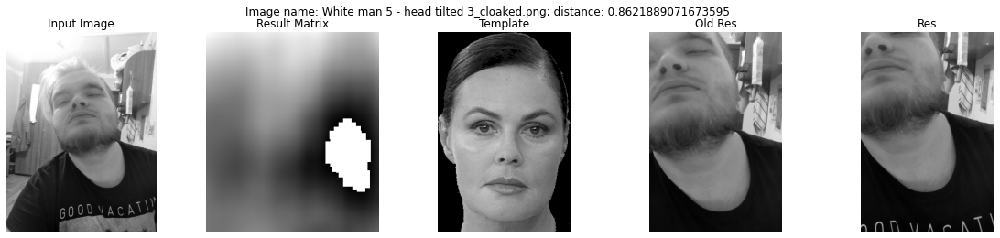

  0%|          | 0/2000 [00:00<?, ?it/s]

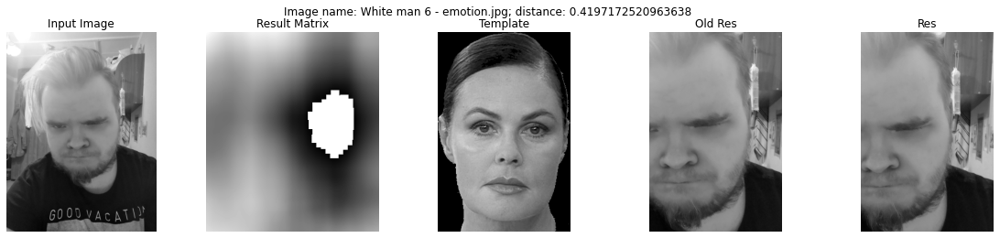

  0%|          | 0/2000 [00:00<?, ?it/s]

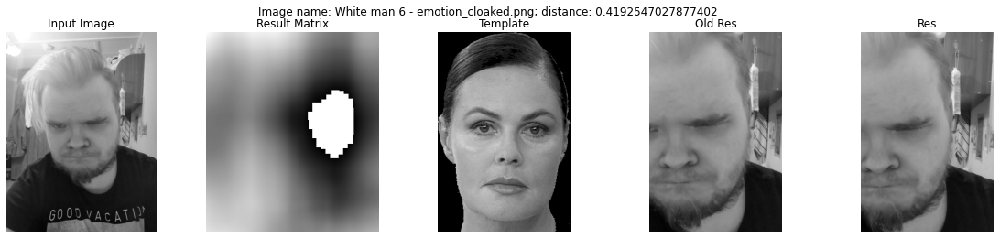

  0%|          | 0/2000 [00:00<?, ?it/s]

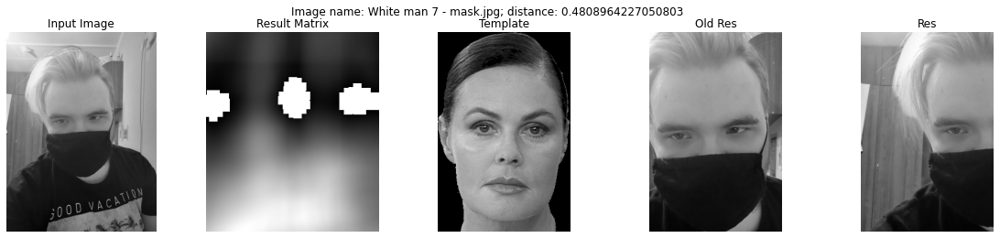

  0%|          | 0/2000 [00:00<?, ?it/s]

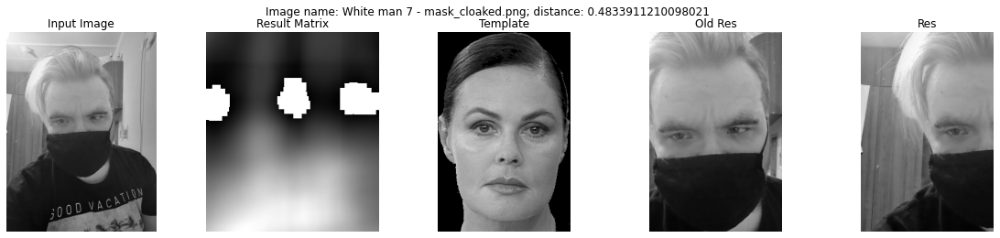

  0%|          | 0/2000 [00:00<?, ?it/s]

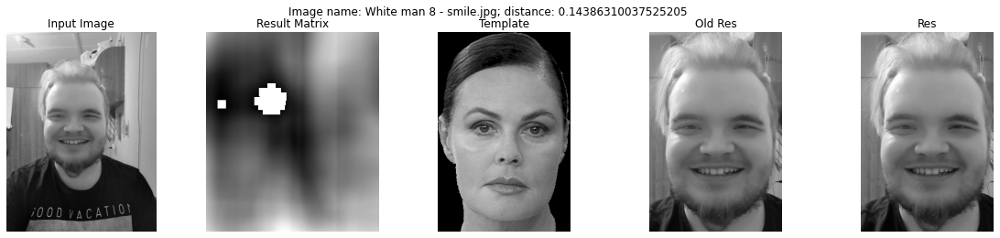

  0%|          | 0/2000 [00:00<?, ?it/s]

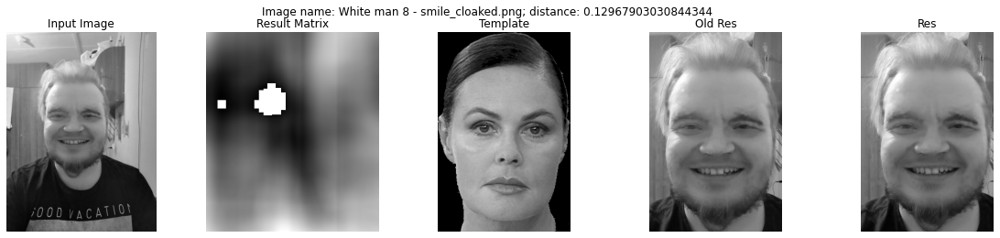

  0%|          | 0/2000 [00:00<?, ?it/s]

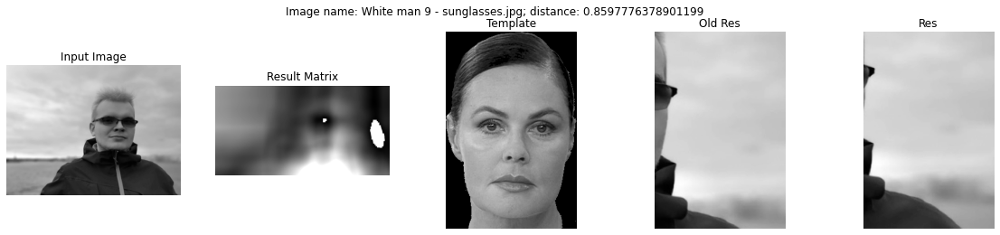

  0%|          | 0/2000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [9]:
templates_folder_name = 'templates'
images_folder_name = 'images'
method = "cv.TM_SQDIFF_NORMED"
face_template_name = '3_1.png'
template_names = ['3_2.png', '3_3.jpg', '3_4.jpg', '3_5.jpg', '3_6.jpg', '3_7.jpg', '3_8.jpg']

face_template = cv.imread(f'{templates_folder_name}/{face_template_name}',0)
templates = []
for template_name in template_names:
    templates.append(cv.imread(f'{templates_folder_name}/{template_name}',0))

locations = []
for i in range(len(templates)):
    template = templates[i] 
    res = cv.matchTemplate(face_template,template,eval(method))
    min_val, _, min_loc, _ = cv.minMaxLoc(res)
    locations.append(min_loc[::-1])

treshold = 0.1
del_range = 5
mult = 0
max_count = int(7.0 / mult) if abs(mult) > 1e-6 else 2000
    
for image_name in os.listdir(images_folder_name):
    img = cv.imread(f'{images_folder_name}/{image_name}',0)
    
    top_left, bottom_right = face_recogn2(img, [face_template], method)
    cropped_img2 = img[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
    
    top_left, bottom_right, res_matrix, dist = face_recogn3(img, [(face_template, templates, locations)])
    cropped_img3 = img[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
    
    plt.rcParams["figure.figsize"] = (20,4)
    plt.subplot(1, 5, 1), plt.imshow(img,cmap = 'gray')
    plt.title('Input Image'), plt.axis("off")
    plt.subplot(1, 5, 2), plt.imshow(res_matrix,cmap = 'gray')
    plt.title('Result Matrix'), plt.axis("off")
    plt.subplot(1, 5, 3), plt.imshow(face_template,cmap = 'gray')
    plt.title('Template'), plt.axis("off")
    plt.subplot(1, 5, 4), plt.imshow(cropped_img2,cmap = 'gray')
    plt.title('Old Res'), plt.axis("off")
    plt.subplot(1, 5, 5), plt.imshow(cropped_img3,cmap = 'gray')
    plt.title('Res'), plt.axis("off")
    plt.suptitle(f"Image name: {image_name}; distance: {dist}")
    plt.show()

Задание

1. Провести те же исследования для детектора Виола-Джонса (есть в OpenCV и MATLAB).
2. Сделать выводы по проделанной работе.

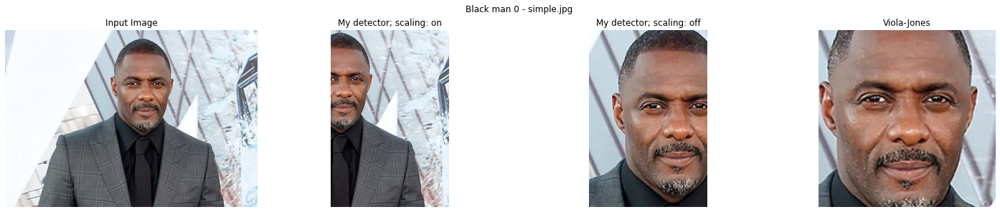

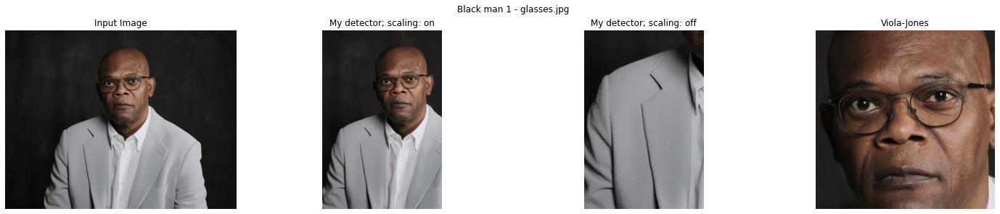

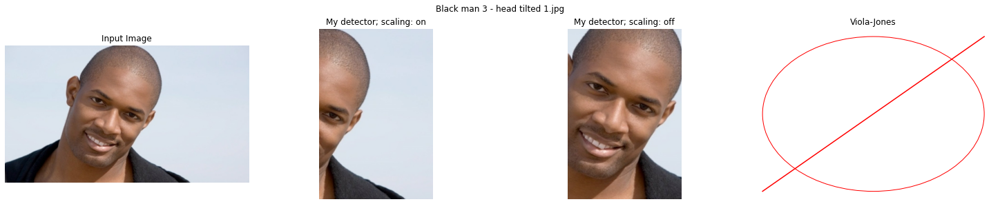

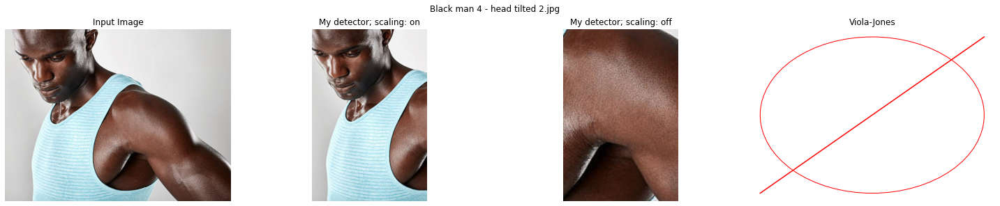

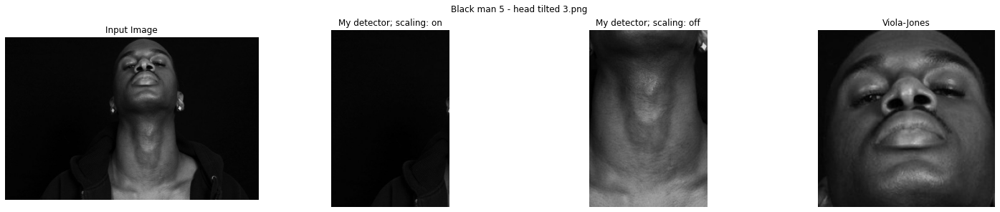

...

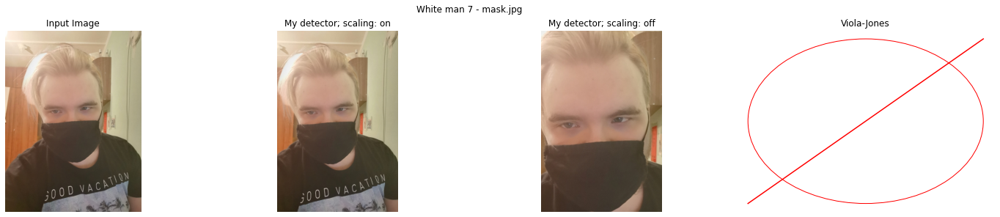

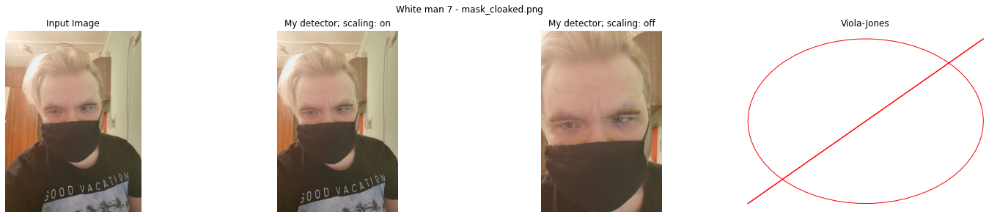

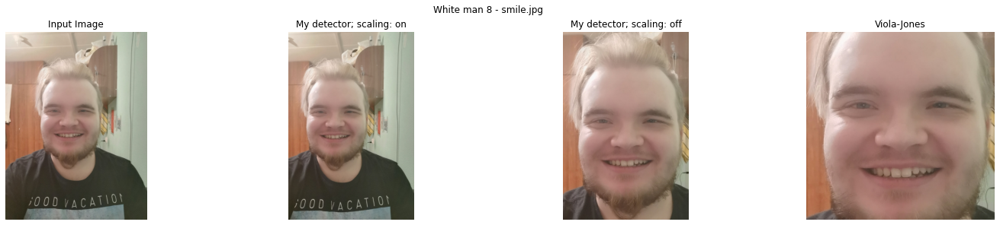

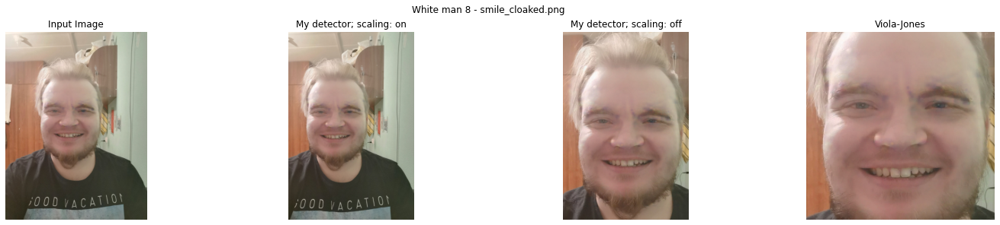

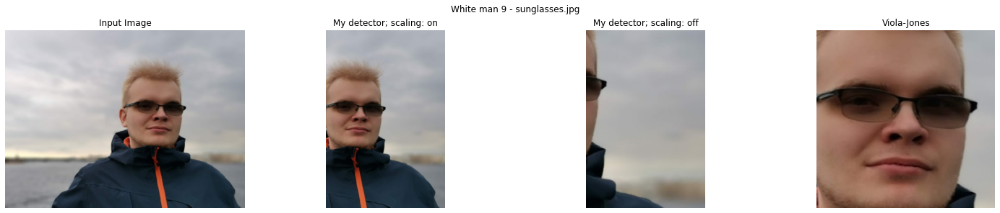

KeyboardInterrupt: 

In [10]:
images_folder_name = 'images'
templates_folder_name = 'templates'
method1 = "cv.TM_CCOEFF"
template_name1 = '1_1.png'
method2 = "cv.TM_SQDIFF_NORMED"
template_name2 = '3_1.png'

template1 = cv.imread(f'{templates_folder_name}/{template_name1}', 0)
template2 = cv.imread(f'{templates_folder_name}/{template_name2}', 0)

face_cascade = cv.CascadeClassifier(cv.data.haarcascades + 'haarcascade_frontalface_default.xml')

for image_name in os.listdir(images_folder_name):
    img = cv.imread(f'{images_folder_name}/{image_name}')

    detected_faces = face_cascade.detectMultiScale(img)
    res4 = img
    
    max_idx = -1
    max_area = 0
    for i in range(len(detected_faces)):
        _, _, width, height = detected_faces[i]
        if width * height > max_area:
            max_area = width * height
            max_idx = i
    
    gray_img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    top_left, bottom_right = face_recogn1(gray_img, [template1], method)
    res1 = img[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
    
    top_left, bottom_right = face_recogn2(gray_img, [template2], method)
    res2 = img[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
    
    
    plt.rcParams["figure.figsize"] = (20,4)
    plt.rcParams['figure.constrained_layout.use'] = True
    plt.subplot(1, 4, 1), plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.title('Input Image'), plt.axis("off")
    plt.subplot(1, 4, 2), plt.imshow(cv.cvtColor(res1, cv.COLOR_BGR2RGB))
    plt.title('My detector; scaling: on'), plt.axis("off")
    plt.subplot(1, 4, 3), plt.imshow(cv.cvtColor(res2, cv.COLOR_BGR2RGB))
    plt.title('My detector; scaling: off'), plt.axis("off")
    
    plt.subplot(1, 4, 4), plt.title('Viola-Jones'), plt.axis("off")
    if max_idx >= 0:
        column, row, width, height = detected_faces[max_idx]
        res4 = img[row:row+height, column:column+width]
        plt.imshow(cv.cvtColor(res4, cv.COLOR_BGR2RGB))
    else:
        x = np.linspace(0, 5, 1000)
        plt.plot(x, x, color='r')
        ax = plt.gca()
        circle = plt.Circle((2.5, 2.5), 2.5, color='r', fill=False)
        ax.add_patch(circle)
    
    plt.suptitle(f"{image_name}")
    plt.show()